Kaggle Marketing Data를 활용한 딥러닝 예측 모델링

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import os

In [4]:
# os.environ을 이용하여 Kaggle API Username, Key 세팅하기
os.environ['KAGGLE_USERNAME'] = 'stephanlee'
os.environ['KAGGLE_KEY'] = 'ef824400882a00b247e73c08a812cca1'

In [5]:
#Kaggle에서 데이터 가지고 오기
!kaggle datasets download -d jackdaoud/marketing-data

  0% 0.00/643k [00:00<?, ?B/s]
100% 643k/643k [00:00<00:00, 138MB/s]


In [6]:
#압축 풀기
!unzip '*.zip'

Archive:  marketing-data.zip
  inflating: dictionary.png          
  inflating: ifood_df.csv            


In [8]:
!ls

dictionary.png	ifood_df.csv  marketing-data.zip  sample_data


In [13]:
!ls sample_data

anscombe.json		      mnist_test.csv
california_housing_test.csv   mnist_train_small.csv
california_housing_train.csv  README.md


In [9]:
#pandas를 이용해 csv파일을 dataframe으로 옮기기
df = pd.read_csv('ifood_df.csv')

In [10]:
#dataframe의 앞부분 출력을 통해 정상적으로 데이터가 들어왔는지 확인
df.head()

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,marital_Together,marital_Widow,education_2n Cycle,education_Basic,education_Graduation,education_Master,education_PhD,MntTotal,MntRegularProds,AcceptedCmpOverall
0,58138.0,0,0,58,635,88,546,172,88,88,...,0,0,0,0,1,0,0,1529,1441,0
1,46344.0,1,1,38,11,1,6,2,1,6,...,0,0,0,0,1,0,0,21,15,0
2,71613.0,0,0,26,426,49,127,111,21,42,...,1,0,0,0,1,0,0,734,692,0
3,26646.0,1,0,26,11,4,20,10,3,5,...,1,0,0,0,1,0,0,48,43,0
4,58293.0,1,0,94,173,43,118,46,27,15,...,0,0,0,0,0,0,1,407,392,0


In [11]:
#dataframe information 정보로 결측값 유무, 데이터 타입 등을 활용 -> 수치형인지(int, float), string 데이터인지, category인지에 따라 전처리 방법을 다르게 가져감
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2205 entries, 0 to 2204
Data columns (total 39 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Income                2205 non-null   float64
 1   Kidhome               2205 non-null   int64  
 2   Teenhome              2205 non-null   int64  
 3   Recency               2205 non-null   int64  
 4   MntWines              2205 non-null   int64  
 5   MntFruits             2205 non-null   int64  
 6   MntMeatProducts       2205 non-null   int64  
 7   MntFishProducts       2205 non-null   int64  
 8   MntSweetProducts      2205 non-null   int64  
 9   MntGoldProds          2205 non-null   int64  
 10  NumDealsPurchases     2205 non-null   int64  
 11  NumWebPurchases       2205 non-null   int64  
 12  NumCatalogPurchases   2205 non-null   int64  
 13  NumStorePurchases     2205 non-null   int64  
 14  NumWebVisitsMonth     2205 non-null   int64  
 15  AcceptedCmp3         

In [14]:
#데이터 정보의 요약 -> min max 값 및 중간값을 보고 어떻게 scaling 할 지 결정할 수 있음. 편중된 데이터의 경우, 상관분석을 통해 제외할지를 결정
df.describe()

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,marital_Together,marital_Widow,education_2n Cycle,education_Basic,education_Graduation,education_Master,education_PhD,MntTotal,MntRegularProds,AcceptedCmpOverall
count,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,...,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.000000,2205.00000
mean,51622.094785,0.442177,0.506576,49.009070,306.164626,26.403175,165.312018,37.756463,27.128345,44.057143,...,0.257596,0.034467,0.089796,0.024490,0.504762,0.165079,0.215873,562.764626,518.707483,0.29932
std,20713.063826,0.537132,0.544380,28.932111,337.493839,39.784484,217.784507,54.824635,41.130468,51.736211,...,0.437410,0.182467,0.285954,0.154599,0.500091,0.371336,0.411520,575.936911,553.847248,0.68044
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,-283.000000,0.00000
25%,35196.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,1.000000,9.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,56.000000,42.000000,0.00000
50%,51287.000000,0.000000,0.000000,49.000000,178.000000,8.000000,68.000000,12.000000,8.000000,25.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,343.000000,288.000000,0.00000
75%,68281.000000,1.000000,1.000000,74.000000,507.000000,33.000000,232.000000,50.000000,34.000000,56.000000,...,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,964.000000,884.000000,0.00000
max,113734.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2491.000000,2458.000000,4.00000


In [23]:
#우리가 예측해야 할 데이터가 어떠한 데이터 타입인지 확인 -> 여기서는 0 또는 1의 값으로, boolean 타입
pd.unique(df['Response'])

array([1, 0])

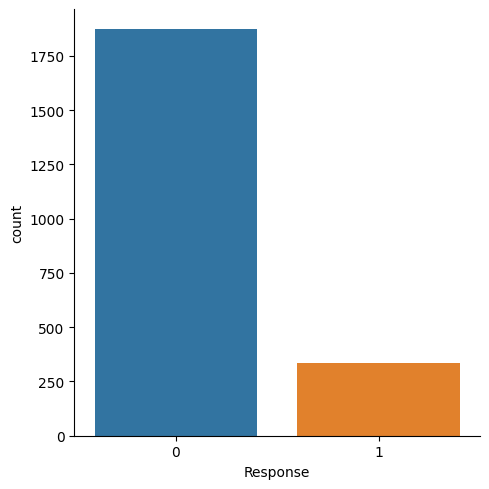

In [25]:
sns.catplot(data=df,x='Response',kind='count')

In [26]:
sns.pairplot(data=df, hue='Response')

<Axes: xlabel='Response', ylabel='MntRegularProds'>

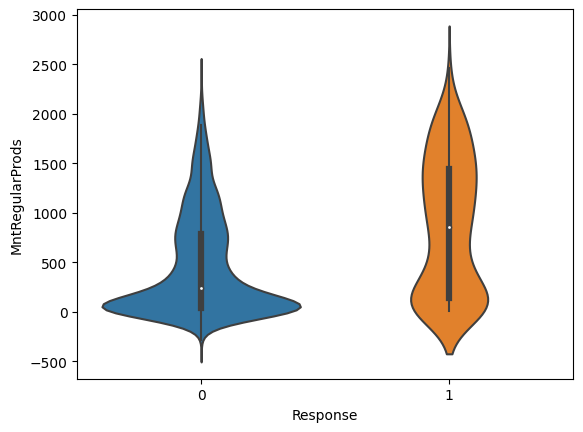

In [27]:
sns.violinplot(data=df, x='Response',y='MntRegularProds')

<Axes: xlabel='Response', ylabel='MntWines'>

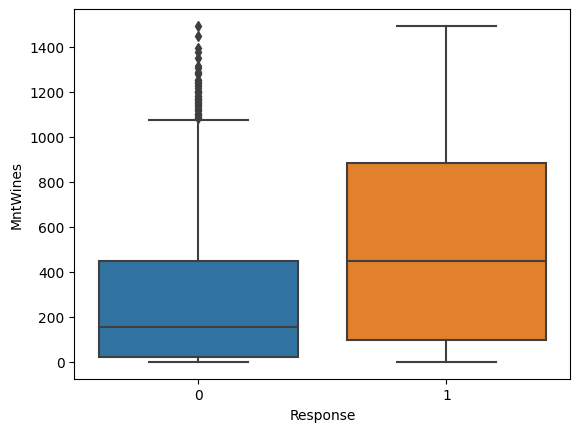

In [28]:
sns.boxplot(data=df,x='Response',y='MntWines')

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 37.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<Axes: xlabel='Response', ylabel='MntTotal'>

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:3544: UserWarning: 54.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


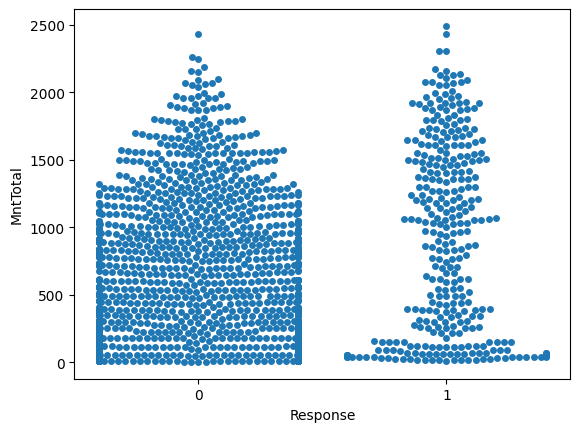

In [30]:
sns.swarmplot(data=df, x='Response', y='MntTotal')

In [38]:
df.max(0)

Income                  113734.0
Kidhome                      2.0
Teenhome                     2.0
Recency                     99.0
MntWines                  1493.0
MntFruits                  199.0
MntMeatProducts           1725.0
MntFishProducts            259.0
MntSweetProducts           262.0
MntGoldProds               321.0
NumDealsPurchases           15.0
NumWebPurchases             27.0
NumCatalogPurchases         28.0
NumStorePurchases           13.0
NumWebVisitsMonth           20.0
AcceptedCmp3                 1.0
AcceptedCmp4                 1.0
AcceptedCmp5                 1.0
AcceptedCmp1                 1.0
AcceptedCmp2                 1.0
Complain                     1.0
Z_CostContact                3.0
Z_Revenue                   11.0
Response                     1.0
Age                         80.0
Customer_Days             2858.0
marital_Divorced             1.0
marital_Married              1.0
marital_Single               1.0
marital_Together             1.0
marital_Wi

In [40]:
df[['Income','Kidhome','Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth', 'Z_CostContact', 'Z_Revenue', 'Age', 'Customer_Days', 'MntTotal', 'MntRegularProds', 'AcceptedCmpOverall']]

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntSweetProducts,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Z_CostContact,Z_Revenue,Age,Customer_Days,MntTotal,MntRegularProds,AcceptedCmpOverall
0,58138.0,0,0,58,635,88,546,172,88,88,...,10,4,7,3,11,63,2822,1529,1441,0
1,46344.0,1,1,38,11,1,6,2,1,1,...,1,2,5,3,11,66,2272,21,15,0
2,71613.0,0,0,26,426,49,127,111,21,21,...,2,10,4,3,11,55,2471,734,692,0
3,26646.0,1,0,26,11,4,20,10,3,3,...,0,4,6,3,11,36,2298,48,43,0
4,58293.0,1,0,94,173,43,118,46,27,27,...,3,6,5,3,11,39,2320,407,392,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2200,61223.0,0,1,46,709,43,182,42,118,118,...,3,4,5,3,11,53,2540,1094,847,0
2201,64014.0,2,1,56,406,0,30,0,0,0,...,2,5,7,3,11,74,2178,436,428,1
2202,56981.0,0,0,91,908,48,217,32,12,12,...,3,13,6,3,11,39,2314,1217,1193,1
2203,69245.0,0,1,8,428,30,214,80,30,30,...,5,10,3,3,11,64,2315,782,721,0


In [41]:
from sklearn.preprocessing import StandardScaler

In [43]:
scaler = StandardScaler()
scaled_df= pd.DataFrame(data=scaler.fit_transform(df),columns=df.columns)

In [44]:
scaled_df

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,marital_Together,marital_Widow,education_2n Cycle,education_Basic,education_Graduation,education_Master,education_PhD,MntTotal,MntRegularProds,AcceptedCmpOverall
0,0.314651,-0.823405,-0.930767,0.310830,0.974566,1.548614,1.748400,2.449154,1.480301,0.849556,...,-0.589047,-0.188938,-0.314093,-0.158444,0.990521,-0.444656,-0.524694,1.678056,1.665625,-0.439991
1,-0.254877,1.038757,0.906602,-0.380600,-0.874776,-0.638664,-0.731678,-0.652345,-0.635399,-0.735767,...,-0.589047,-0.188938,-0.314093,-0.158444,0.990521,-0.444656,-0.524694,-0.940880,-0.909676,-0.439991
2,0.965354,-0.823405,-0.930767,-0.795458,0.355155,0.568110,-0.175957,1.336263,-0.149031,-0.039771,...,1.697658,-0.188938,-0.314093,-0.158444,0.990521,-0.444656,-0.524694,0.297384,0.312960,-0.439991
3,-1.206087,1.038757,-0.930767,-0.795458,-0.874776,-0.563241,-0.667380,-0.506392,-0.586763,-0.755100,...,1.697658,-0.188938,-0.314093,-0.158444,0.990521,-0.444656,-0.524694,-0.893989,-0.859109,-0.439991
4,0.322136,1.038757,-0.930767,1.555404,-0.394659,0.417263,-0.217292,0.150396,-0.003121,-0.561768,...,-0.589047,-0.188938,-0.314093,-0.158444,-1.009570,-0.444656,1.905873,-0.270516,-0.228829,-0.439991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2200,0.463624,-0.823405,0.906602,-0.104028,1.193879,0.417263,0.076644,0.077420,2.209853,3.923536,...,-0.589047,-0.188938,-0.314093,-0.158444,0.990521,-0.444656,-0.524694,0.922594,0.592884,-0.439991
2201,0.598401,2.900920,0.906602,0.241687,0.295881,-0.663806,-0.621452,-0.688833,-0.659718,-0.697100,...,1.697658,-0.188938,-0.314093,-0.158444,-1.009570,-0.444656,1.905873,-0.220152,-0.163814,1.029979
2202,0.258780,-0.823405,-0.930767,1.451690,1.783653,0.542969,0.237389,-0.105022,-0.367897,-0.387769,...,-0.589047,-0.188938,-0.314093,-0.158444,0.990521,-0.444656,-0.524694,1.136207,1.217746,1.029979
2203,0.851004,-0.823405,0.906602,-1.417746,0.361082,0.090428,0.223611,0.770696,0.069834,0.327560,...,1.697658,-0.188938,-0.314093,-0.158444,-1.009570,2.248931,-0.524694,0.380745,0.365333,-0.439991


In [45]:
from sklearn.model_selection import train_test_split

In [47]:
X = df.drop('Response',axis=1)

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X,df['Response'],test_size=0.3,stratify=df['Response'])

In [49]:
from xgboost import XGBClassifier

In [50]:
# XGBClassifier 모델 생성/학습
model_xgb = XGBClassifier()
model_xgb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [51]:
from sklearn.metrics import classification_report

In [52]:
# Predict를 수행하고 classification_report() 결과 출력하기
pred = model_xgb.predict(X_test)
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       0.93      0.96      0.94       562
           1       0.71      0.60      0.65       100

    accuracy                           0.90       662
   macro avg       0.82      0.78      0.80       662
weighted avg       0.90      0.90      0.90       662



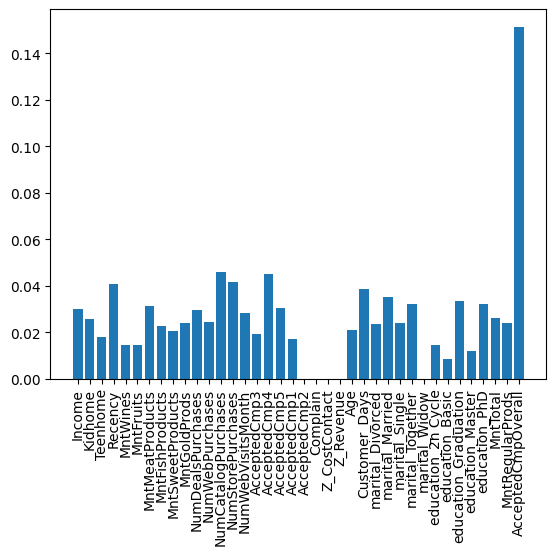

In [53]:
plt.bar(X.columns,model_xgb.feature_importances_)
plt.xticks(rotation=90)
plt.show()

In [55]:
from sklearn.metrics import precision_recall_curve

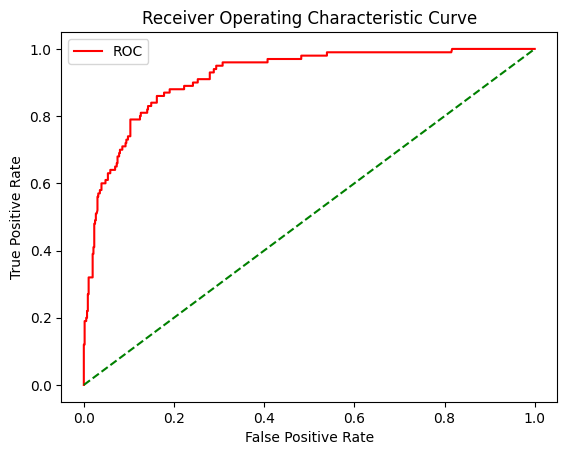

In [60]:
# 두 모델의 Precision-Recall 커브를 한번에 그리기 (힌트: fig.gca()로 ax를 반환받아 사용)

from sklearn.metrics import roc_curve

def plot_roc_curve(fper, tper):
    plt.plot(fper, tper, color='red', label='ROC')
    plt.plot([0, 1], [0, 1], color='green', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic Curve')
    plt.legend()
    plt.show()

probs = model_xgb.predict_proba(X_test)
prob = probs[:, 1]
fper, tper, thresholds = roc_curve(y_test, prob)
plot_roc_curve(fper, tper)